# Face Generation

In this project, you'll define and train a Generative Adverserial network of your own creation on a dataset of faces. Your goal is to get a generator network to generate *new* images of faces that look as realistic as possible!

The project will be broken down into a series of tasks from **defining new architectures training adversarial networks**. At the end of the notebook, you'll be able to visualize the results of your trained Generator to see how it performs; your generated samples should look like fairly realistic faces with small amounts of noise.

### Get the Data

You'll be using the [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) to train your adversarial networks.

This dataset has higher resolution images than datasets you have previously worked with (like MNIST or SVHN) you've been working with, and so, you should prepare to define deeper networks and train them for a longer time to get good results. It is suggested that you utilize a GPU for training.

### Pre-processed Data

Since the project's main focus is on building the GANs, we've done *some* of the pre-processing for you. Each of the CelebA images has been cropped to remove parts of the image that don't include a face, then resized down to 64x64x3 NumPy images. Some sample data is show below.

<img src='assets/processed_face_data.png' width=60% />

> If you are working locally, you can download this data [by clicking here](https://s3.amazonaws.com/video.udacity-data.com/topher/2018/November/5be7eb6f_processed-celeba-small/processed-celeba-small.zip)

This is a zip file that you'll need to extract in the home directory of this notebook for further loading and processing. After extracting the data, you should be left with a directory of data `processed-celeba-small/`.

In [ ]:
# run this once to unzip the file
!unzip processed-celeba-small.zip

In [1]:
from typing import Tuple, Callable

import matplotlib.pyplot as plt
import numpy as np
from torch.utils.data import DataLoader
from torchvision.transforms import (
    Compose,
    ToTensor,
    Normalize,
    Resize
)

import tests

In [2]:
data_dir = 'processed_celeba_small/celeba/'

## Data pipeline

The [CelebA](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations. Since you're going to be generating faces, you won't need the annotations, you'll only need the images. Note that these are color images with [3 color channels (RGB)](https://en.wikipedia.org/wiki/Channel_(digital_image)#RGB_Images) each.

### Pre-process and Load the Data

Since the project's main focus is on building the GANs, we've done *some* of the pre-processing for you. Each of the CelebA images has been cropped to remove parts of the image that don't include a face, then resized down to 64x64x3 NumPy images. This *pre-processed* dataset is a smaller subset of the very large CelebA dataset and contains roughly 30,000 images. 

Your first task consists in building the dataloader. To do so, you need to do the following:
* implement the get_transforms function
* create a custom Dataset class that reads the CelebA data

### Exercise: implement the get_transforms function

The `get_transforms` function should output a [`torchvision.transforms.Compose`](https://pytorch.org/vision/stable/generated/torchvision.transforms.Compose.html#torchvision.transforms.Compose) of different transformations. You have two constraints:
* the function takes a tuple of size as input and should **resize the images** to the input size
* the output images should have values **ranging from -1 to 1**

In [3]:
def get_transforms(size: Tuple[int, int]) -> Callable:
    """
    Transforms to apply to the image.
    Args:
        size: Target size of the images
    Returns:
        Composition of transforms
    """
    transforms = [
        Resize(size),
        ToTensor(),
        Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ]
    return Compose(transforms)

### Exercise: implement the DatasetDirectory class


The `DatasetDirectory` class is a torch Dataset that reads from the above data directory. The `__getitem__` method should output a transformed tensor and the `__len__` method should output the number of files in our dataset. You can look at [this custom dataset](https://pytorch.org/tutorials/beginner/basics/data_tutorial.html#creating-a-custom-dataset-for-your-files) for ideas. 

In [5]:
from PIL import Image
import torch
from torch.utils.data import Dataset
import os
from typing import Callable


class DatasetDirectory(Dataset):
    """A PyTorch Dataset class for loading images from a directory.
    
    Args:
        directory (str): Path to directory containing image files
        transforms (Callable, optional): Transformations to apply to images. Defaults to basic 64x64 transforms.
        extension (str, optional): File extension to filter by. Defaults to '.jpg'.
    
    Attributes:
        directory (str): Directory containing images
        image_files (list): Sorted list of image file paths
        transforms (Callable): Image transformation function
    
    Methods:
        __len__(): Returns number of images in dataset
        __getitem__(index): Returns transformed image tensor at given index
    
    Example:
        >>> dataset = DatasetDirectory('path/to/images')
        >>> len(dataset)  # Number of images
        100
        >>> image = dataset[0]  # First image tensor
    """
    def __init__(self, directory: str, transforms: Callable = None, extension: str = '.jpg'):
        """Initialize dataset with directory of images."""
        self.directory = directory
        self.image_files = sorted([
            os.path.join(directory, f)
            for f in os.listdir(directory)
            if f.endswith(extension)
        ])

        # Default transform if none provided
        self.transforms = transforms if transforms else get_transforms((64, 64))

    def __len__(self) -> int:
        return len(self.image_files)

    def __getitem__(self, index: int) -> torch.Tensor:
        """Get a single image."""
        # Get image path
        image_path = self.image_files[index]

        # Load and convert image to RGB
        image = Image.open(image_path).convert('RGB')

        # Apply transforms
        if self.transforms:
            image = self.transforms(image)

        return image

In [6]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
dataset = DatasetDirectory(data_dir, get_transforms((64, 64)))
tests.check_dataset_outputs(dataset)

Congrats, your dataset implementation passed all the tests


The functions below will help you visualize images from the dataset.

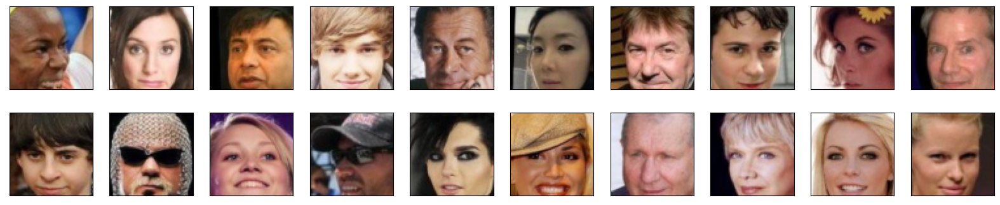

In [ ]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""

def denormalize(images):
    """Transform images from [-1.0, 1.0] to [0, 255] and cast them to uint8.
        Convert normalized image tensors back to displayable uint8 format.
    
    Args:
        images (numpy.ndarray): Image array in range [-1.0, 1.0]
        
    Returns:
        numpy.ndarray: Image array in range [0, 255] as uint8
    
    Example:
        >>> normalized = np.random.uniform(-1, 1, (3, 64, 64))
        >>> display_ready = denormalize(normalized)  # (64, 64, 3) uint8 array
    """
    return ((images + 1.) / 2. * 255).astype(np.uint8)


# Visualization code documentation:
"""
Visualizes a batch of images from the dataset.

Creates a 2-row grid of images with:
- 20 total subplots (10 per row) 
- No axis ticks
- Each image is:
  1. Converted to numpy array
  2. Transposed from (C,H,W) to (H,W,C) 
  3. Denormalized from [-1,1] to [0,255]
  4. Displayed using matplotlib

Parameters:
- figsize: Tuple controlling figure dimensions (20,4) inches
- plot_size: Number of images to display (20)
- dataset: PyTorch dataset containing normalized images

plot the images in the batch, along with the corresponding labels
"""

fig = plt.figure(figsize=(20, 4))
plot_size = 20
for idx in np.arange(plot_size):
    ax = fig.add_subplot(2, int(plot_size / 2), idx + 1, xticks=[], yticks=[])
    img = dataset[idx].numpy()
    img = np.transpose(img, (1, 2, 0))
    img = denormalize(img)
    ax.imshow(img)

## Model implementation

As you know, a GAN is comprised of two adversarial networks, a discriminator and a generator. Now that we have a working data pipeline, we need to implement the discriminator and the generator. 

Feel free to implement any additional class or function.

### Exercise: Create the discriminator

The discriminator's job is to score real and fake images. You have two constraints here:
* the discriminator takes as input a **batch of 64x64x3 images**
* the output should be a single value (=score)

Feel free to get inspiration from the different architectures we talked about in the course, such as DCGAN, WGAN-GP or DRAGAN.

#### Some tips
* To scale down from the input image, you can either use `Conv2d` layers with the correct hyperparameters or Pooling layers.
* If you plan on using gradient penalty, do not use Batch Normalization layers in the discriminator.

In [30]:
from torch.nn import Module
import torch
import torch.nn as nn


In [31]:
class Discriminator(Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        # DCGAN-style discriminator
        self.main = nn.Sequential(
            # Input: 3x64x64
            nn.Conv2d(3, 64, 4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),

            # 64x32x32
            nn.Conv2d(64, 128, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),

            # 128x16x16
            nn.Conv2d(128, 256, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),

            # 256x8x8
            nn.Conv2d(256, 512, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),

            # 512x4x4 -> 1x1x1x1
            nn.Conv2d(512, 1, 4, stride=1, padding=0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        return self.main(x).view(-1, 1, 1, 1)


In [32]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
discriminator = Discriminator()
tests.check_discriminator(discriminator)

Congrats, your discriminator implementation passed all the tests


### Exercise: create the generator

The generator's job creates the "fake images" and learns the dataset distribution. You have three constraints here:
* the generator takes as input a vector of dimension `[batch_size, latent_dimension, 1, 1]`
* the generator must outputs **64x64x3 images**

Feel free to get inspiration from the different architectures we talked about in the course, such as DCGAN, WGAN-GP or DRAGAN.

#### Some tips:
* to scale up from the latent vector input, you can use `ConvTranspose2d` layers
* as often with Gan, **Batch Normalization** helps with training

In [33]:
class Generator(Module):
    def __init__(self, latent_dim: int):
        super(Generator, self).__init__()

        self.main = nn.Sequential(
            # Input: latent_dim x 1 x 1
            nn.ConvTranspose2d(latent_dim, 512, 4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),

            # 512 x 4 x 4
            nn.ConvTranspose2d(512, 256, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),

            # 256 x 8 x 8
            nn.ConvTranspose2d(256, 128, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),

            # 128 x 16 x 16
            nn.ConvTranspose2d(128, 64, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),

            # 64 x 32 x 32
            nn.ConvTranspose2d(64, 3, 4, stride=2, padding=1, bias=False),
            nn.Tanh()
            # Output: 3 x 64 x 64
        )

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        return self.main(x)

In [34]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to verify your generator implementation
# latent_dim = 128
latent_dim = 256
generator = Generator(latent_dim)
tests.check_generator(generator, latent_dim)

Congrats, your generator implementation passed all the tests


## Optimizer

In the following section, we create the optimizers for the generator and discriminator. You may want to experiment with different optimizers, learning rates and other hyperparameters as they tend to impact the output quality.

### Exercise: implement the optimizers

In [35]:
import torch.optim as optim


def create_optimizers(generator: Module, discriminator: Module):
    """Creates optimizers for generator and discriminator"""
    
    g_optimizer = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
    d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0001, betas=(0.5, 0.999))  # Lowered discriminator LR

    return g_optimizer, d_optimizer

## Losses implementation

In this section, we are going to implement the loss function for the generator and the discriminator. You can and should experiment with different loss function.

Some tips:
* You can choose the commonly used the binary cross entropy loss or select other losses we have discovered in the course, such as the Wasserstein distance.
* You may want to implement a gradient penalty function as discussed in the course. It is not required and the code will work whether you implement it or not.

### Exercise: implement the generator loss

The generator's goal is to get the discriminator to think its generated images (= "fake" images) are real.

In [36]:
def generator_loss(fake_logits):
    """Generator loss"""
    criterion = nn.BCELoss()
    # Generate labels for fake images as if they were real
    labels = torch.ones_like(fake_logits)
    return criterion(fake_logits, labels)



### Exercise: implement the discriminator loss

We want the discriminator to give high scores to real images and low scores to fake ones and the discriminator loss should reflect that.

In [37]:
def discriminator_loss(real_logits, fake_logits):
    """Discriminator loss"""
    criterion = nn.BCELoss()
    # Real images should be labeled as 1
    real_labels = torch.ones_like(real_logits)
    # Fake images should be labeled as 0
    fake_labels = torch.zeros_like(fake_logits)

    real_loss = criterion(real_logits, real_labels)
    fake_loss = criterion(fake_logits, fake_labels)

    return real_loss + fake_loss

### Exercise (Optional): Implement the gradient Penalty

In the course, we discussed the importance of gradient penalty in training certain types of Gans. Implementing this function is not required and depends on some of the design decision you made (discriminator architecture, loss functions).

In [ ]:
def gradient_penalty(discriminator, real_samples, fake_samples):
    """
    Calculate the gradient penalty loss for WGAN GP
    Args:
        discriminator: the discriminator model
        real_samples: real images from dataset
        fake_samples: generated images from generator
    Returns:
        gradient penalty value
    """
    alpha = torch.rand((real_samples.size(0), 1, 1, 1)).to(real_samples.device)
    
    interpolates = (alpha * real_samples + ((1 - alpha) * fake_samples)).requires_grad_(True)
    
    d_interpolates = discriminator(interpolates)
    
    gradients = torch.autograd.grad(
        outputs=d_interpolates,
        inputs=interpolates,
        grad_outputs=torch.ones_like(d_interpolates).to(real_samples.device),
        create_graph=True,
        retain_graph=True,
        only_inputs=True
    )[0]
    
    gradients = gradients.view(gradients.size(0), -1)
    gradient_norm = gradients.norm(2, dim=1)
    gradient_penalty = ((gradient_norm - 1) ** 2).mean()
    
    return gradient_penalty

## Training


Training will involve alternating between training the discriminator and the generator. You'll use your functions real_loss and fake_loss to help you calculate the discriminator losses.

* You should train the discriminator by alternating on real and fake images
* Then the generator, which tries to trick the discriminator and should have an opposing loss function

### Exercise: implement the generator step and the discriminator step functions

Each function should do the following:
* calculate the loss
* backpropagate the gradient
* perform one optimizer step

In [38]:
def generator_step(generator, discriminator, g_optimizer, batch_size, latent_dim, device):
    """One training step for generator"""
    g_optimizer.zero_grad()

    # Generate fake images
    noise = torch.randn(batch_size, latent_dim, 1, 1, device=device)
    fake_images = generator(noise)

    # Get discriminator output on fake images
    fake_logits = discriminator(fake_images)

    # Calculate generator loss
    g_loss = generator_loss(fake_logits)

    # Backpropagate and update
    g_loss.backward()
    g_optimizer.step()

    return {'loss': g_loss}


def discriminator_step(generator, discriminator, d_optimizer, batch_size, latent_dim, real_images, device):
    """One training step for discriminator"""
    d_optimizer.zero_grad()

    # Get discriminator output on real images
    real_logits = discriminator(real_images)

    # Generate and get output on fake images
    noise = torch.randn(batch_size, latent_dim, 1, 1, device=device)
    with torch.no_grad():
        fake_images = generator(noise)
    fake_logits = discriminator(fake_images)

    # Calculate discriminator loss
    d_loss = discriminator_loss(real_logits, fake_logits)

    # Backpropagate and update
    d_loss.backward()
    d_optimizer.step()

    return {'loss': d_loss}

### Main training loop

You don't have to implement anything here but you can experiment with different hyperparameters.

In [39]:
latent_dim = 256 

# Use for Apple MPS 
if torch.cuda.is_available():
    device = 'cuda'  
elif torch.backends.mps.is_available():
    device = 'mps'  
else:
    device = 'cpu'  

print(f"Using device: {device}")

n_epochs = 50 

# Larger batch sizes stabilize training (reduce if memory is limited)
batch_size = 128  


Using device: mps


In [40]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
print_every = 50

generator = Generator(latent_dim).to(device)
discriminator = Discriminator().to(device)
g_optimizer, d_optimizer = create_optimizers(generator, discriminator)

dataloader = DataLoader(dataset,
                        batch_size=64,
                        shuffle=True,
                        num_workers=0,
                        drop_last=True,
                        pin_memory=False)

In [41]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""


def display(fixed_latent_vector: torch.Tensor):
    """ helper function to display images during training """
    fig = plt.figure(figsize=(14, 4))
    plot_size = 16
    for idx in np.arange(plot_size):
        ax = fig.add_subplot(2, int(plot_size / 2), idx + 1, xticks=[], yticks=[])
        img = fixed_latent_vector[idx, ...].detach().cpu().numpy()
        img = np.transpose(img, (1, 2, 0))
        img = denormalize(img)
        ax.imshow(img)
    plt.show()

### Exercise: implement the training strategy

You should experiment with different training strategies. For example:

* train the generator more often than the discriminator. 
* added noise to the input image
* use label smoothing

Implement with your training strategy below.

Starting Epoch [1/50]...
End of Epoch [1/50]. 2024-11-01 18:57:54 | Epoch [1/50] | Batch 508/509 | d_loss: 1.4551 | g_loss: 1.0298


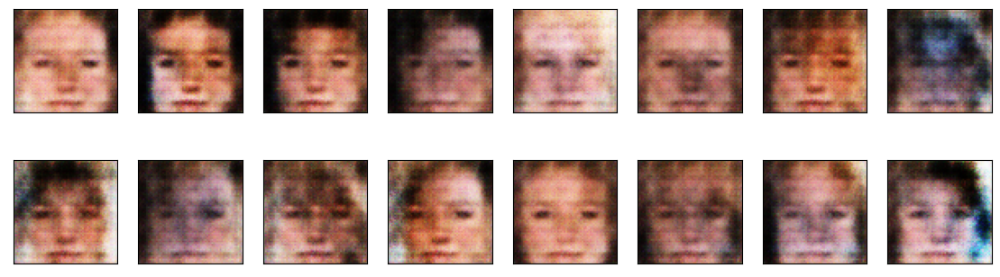

Starting Epoch [2/50]...
End of Epoch [2/50]. 2024-11-01 18:59:39 | Epoch [2/50] | Batch 508/509 | d_loss: 1.5948 | g_loss: 0.5879


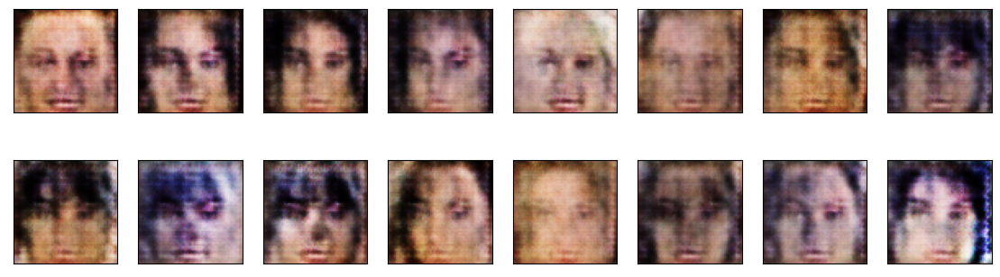

Starting Epoch [3/50]...
End of Epoch [3/50]. 2024-11-01 19:02:02 | Epoch [3/50] | Batch 508/509 | d_loss: 1.3511 | g_loss: 0.9748


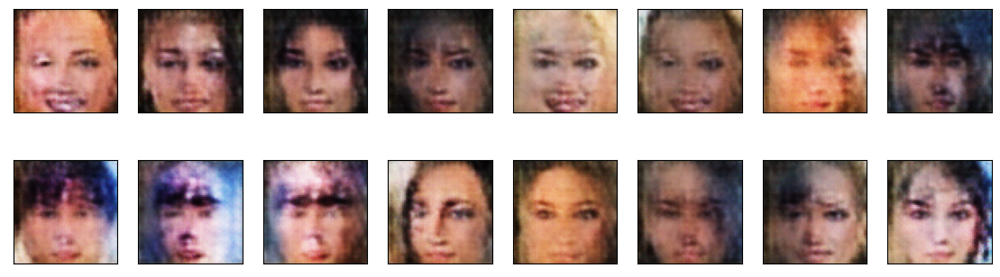

Starting Epoch [4/50]...
End of Epoch [4/50]. 2024-11-01 19:04:35 | Epoch [4/50] | Batch 508/509 | d_loss: 1.3582 | g_loss: 0.8063


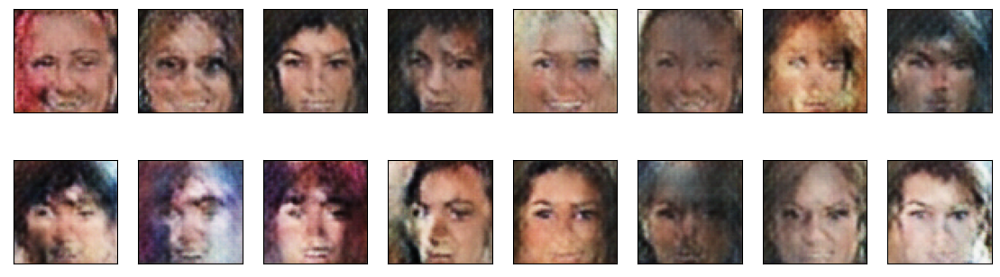

Starting Epoch [5/50]...
End of Epoch [5/50]. 2024-11-01 19:06:38 | Epoch [5/50] | Batch 508/509 | d_loss: 1.2900 | g_loss: 0.9433


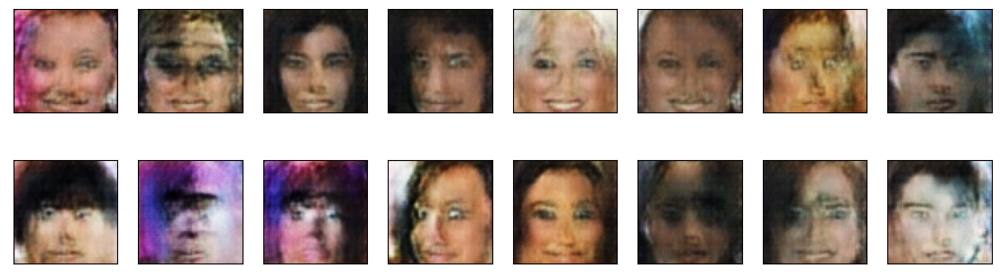

Starting Epoch [6/50]...
End of Epoch [6/50]. 2024-11-01 19:08:36 | Epoch [6/50] | Batch 508/509 | d_loss: 1.3693 | g_loss: 0.6492


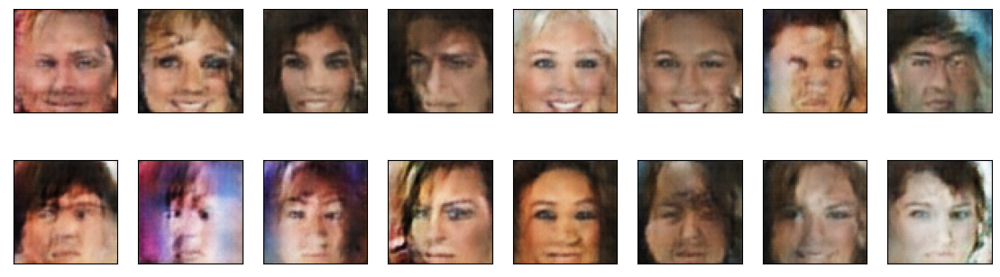

Starting Epoch [7/50]...
End of Epoch [7/50]. 2024-11-01 19:10:33 | Epoch [7/50] | Batch 508/509 | d_loss: 1.2642 | g_loss: 0.9723


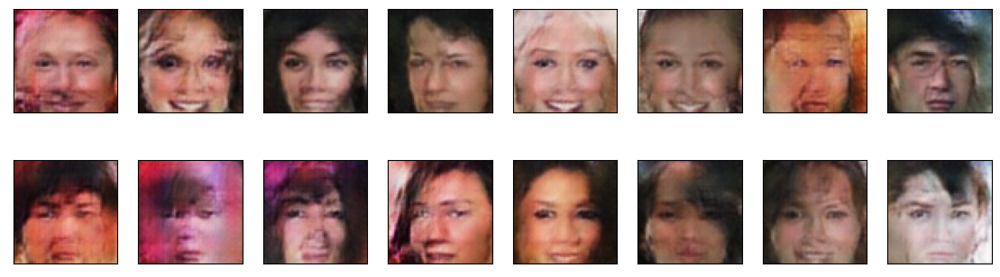

Starting Epoch [8/50]...
End of Epoch [8/50]. 2024-11-01 19:12:31 | Epoch [8/50] | Batch 508/509 | d_loss: 1.4230 | g_loss: 1.0284


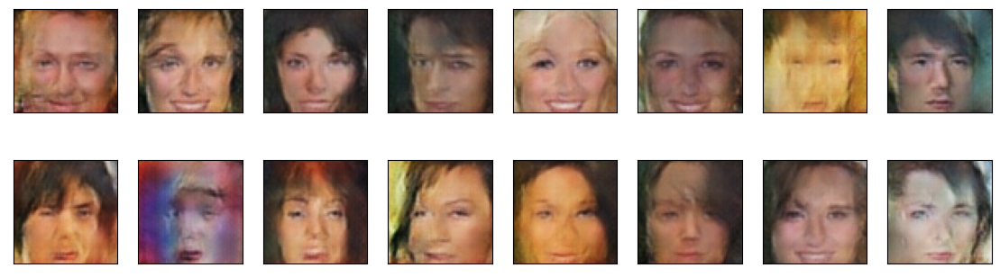

Starting Epoch [9/50]...
End of Epoch [9/50]. 2024-11-01 19:14:34 | Epoch [9/50] | Batch 508/509 | d_loss: 1.0509 | g_loss: 1.2985


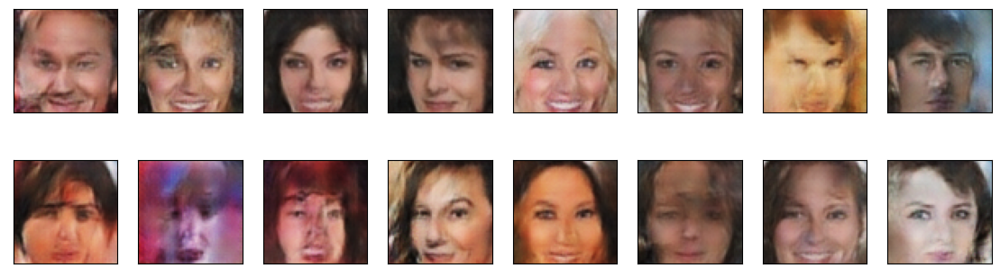

Starting Epoch [10/50]...
End of Epoch [10/50]. 2024-11-01 19:16:37 | Epoch [10/50] | Batch 508/509 | d_loss: 1.1629 | g_loss: 1.1712


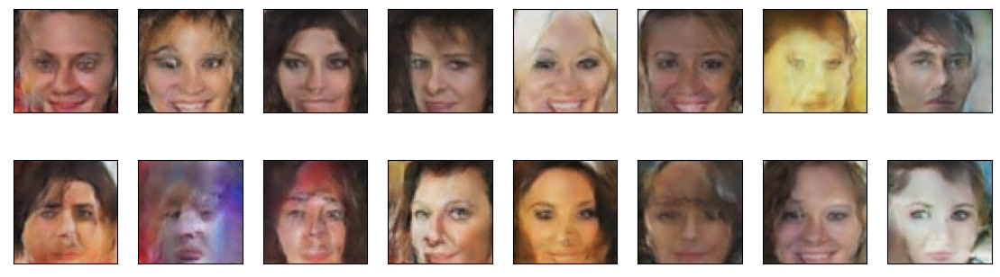

Starting Epoch [11/50]...
End of Epoch [11/50]. 2024-11-01 19:18:39 | Epoch [11/50] | Batch 508/509 | d_loss: 1.4589 | g_loss: 0.4053


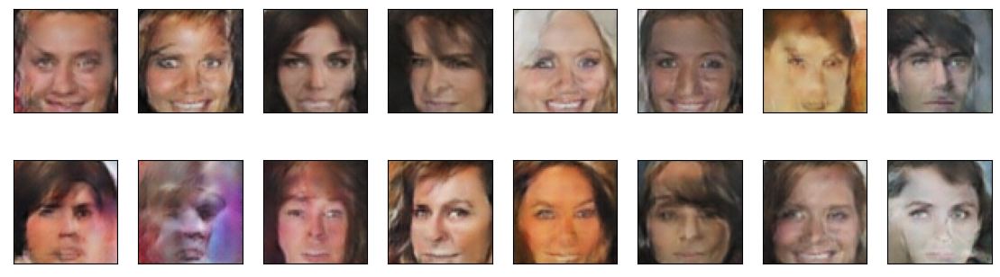

Starting Epoch [12/50]...
End of Epoch [12/50]. 2024-11-01 19:20:40 | Epoch [12/50] | Batch 508/509 | d_loss: 0.7663 | g_loss: 0.6661


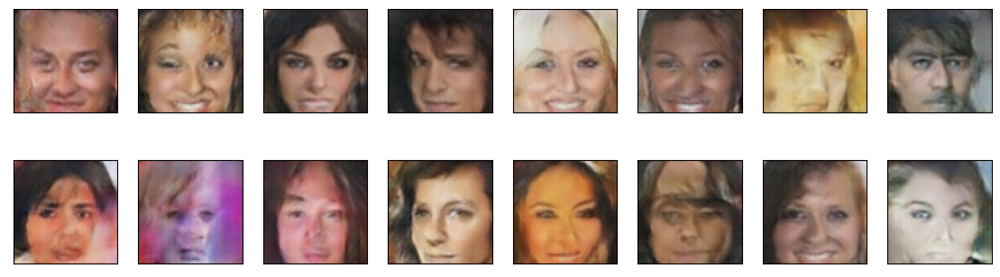

Starting Epoch [13/50]...
End of Epoch [13/50]. 2024-11-01 19:22:42 | Epoch [13/50] | Batch 508/509 | d_loss: 0.7267 | g_loss: 1.0778


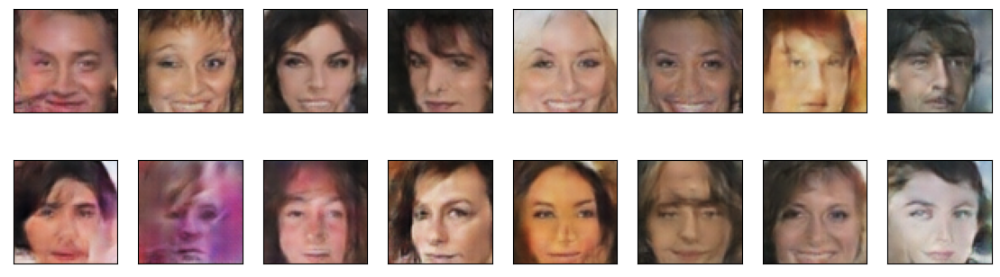

Starting Epoch [14/50]...
End of Epoch [14/50]. 2024-11-01 19:24:43 | Epoch [14/50] | Batch 508/509 | d_loss: 0.8844 | g_loss: 0.9200


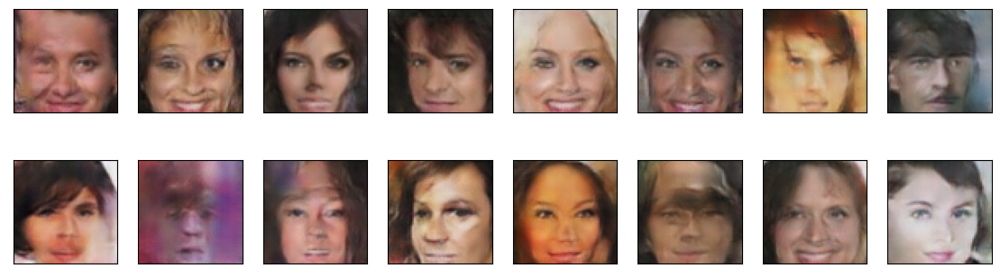

Starting Epoch [15/50]...
End of Epoch [15/50]. 2024-11-01 19:26:44 | Epoch [15/50] | Batch 508/509 | d_loss: 0.5894 | g_loss: 1.5995


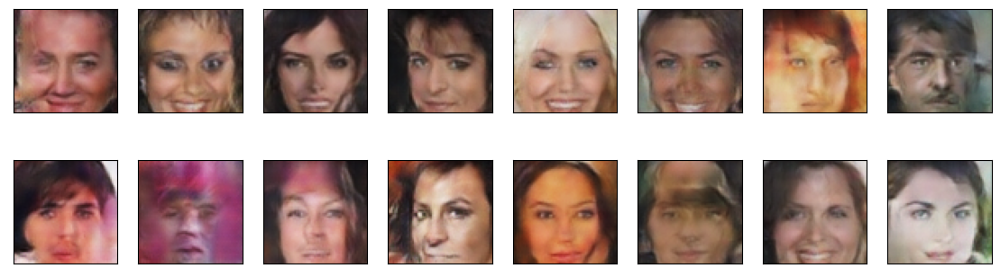

Starting Epoch [16/50]...
End of Epoch [16/50]. 2024-11-01 19:28:46 | Epoch [16/50] | Batch 508/509 | d_loss: 0.7620 | g_loss: 1.4146


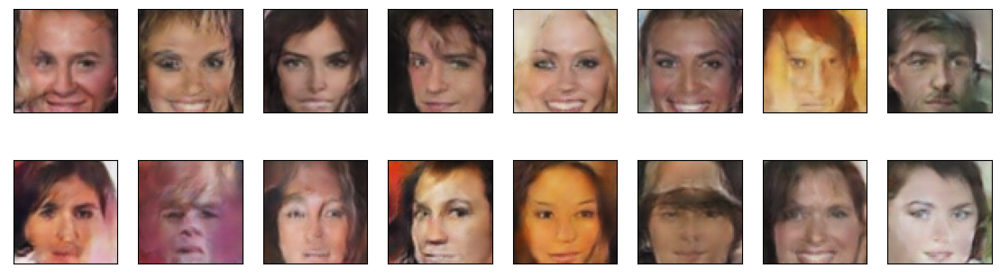

Starting Epoch [17/50]...
End of Epoch [17/50]. 2024-11-01 19:30:48 | Epoch [17/50] | Batch 508/509 | d_loss: 0.5030 | g_loss: 2.5242


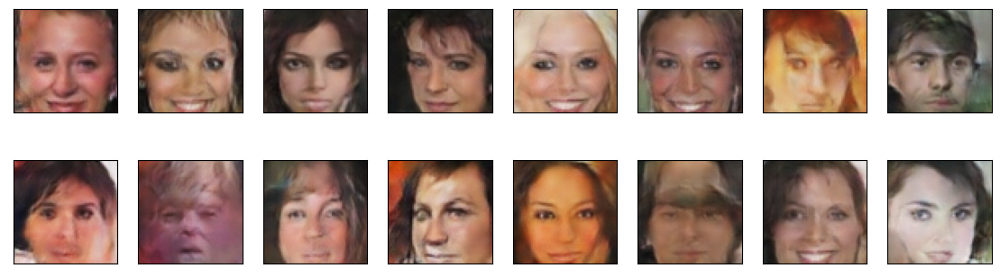

Starting Epoch [18/50]...
End of Epoch [18/50]. 2024-11-01 19:32:50 | Epoch [18/50] | Batch 508/509 | d_loss: 0.8147 | g_loss: 5.0975


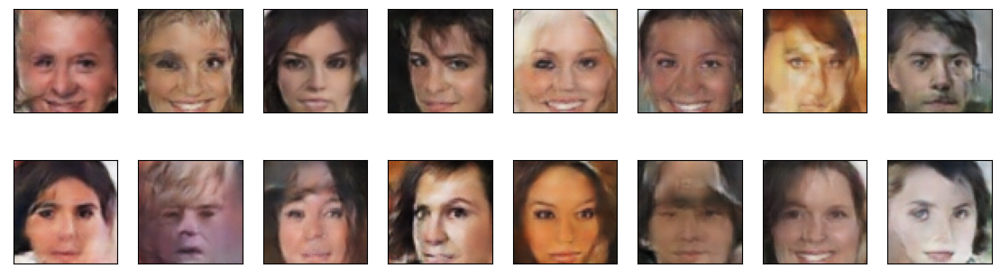

Starting Epoch [19/50]...
End of Epoch [19/50]. 2024-11-01 19:34:50 | Epoch [19/50] | Batch 508/509 | d_loss: 1.0508 | g_loss: 3.4355


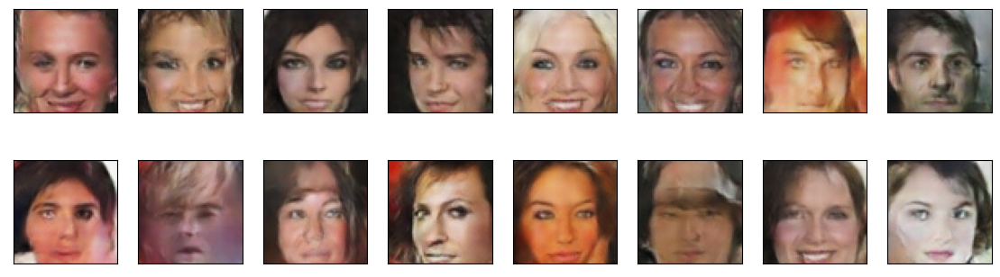

Starting Epoch [20/50]...
End of Epoch [20/50]. 2024-11-01 19:36:51 | Epoch [20/50] | Batch 508/509 | d_loss: 0.4976 | g_loss: 1.3290


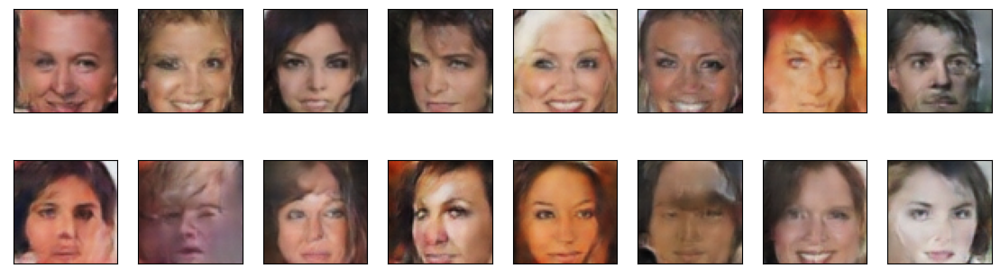

Starting Epoch [21/50]...
End of Epoch [21/50]. 2024-11-01 19:38:52 | Epoch [21/50] | Batch 508/509 | d_loss: 0.4508 | g_loss: 2.6244


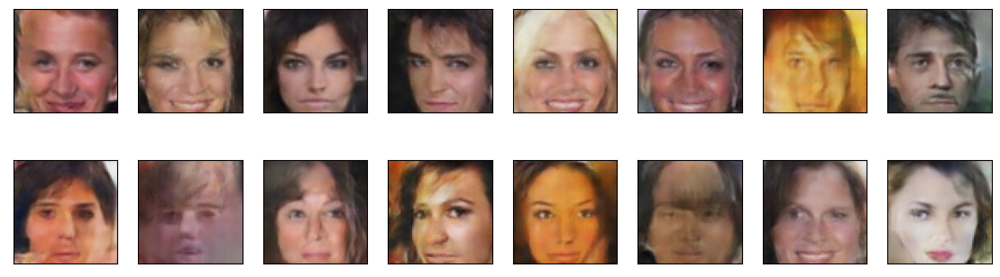

Starting Epoch [22/50]...
End of Epoch [22/50]. 2024-11-01 19:40:55 | Epoch [22/50] | Batch 508/509 | d_loss: 0.1679 | g_loss: 3.3131


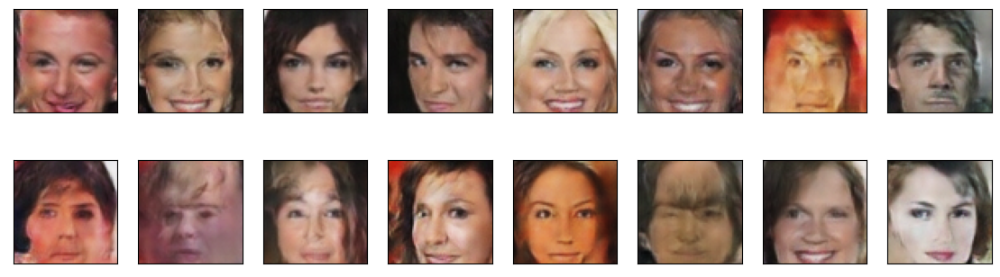

Starting Epoch [23/50]...
End of Epoch [23/50]. 2024-11-01 19:43:03 | Epoch [23/50] | Batch 508/509 | d_loss: 0.6330 | g_loss: 4.9456


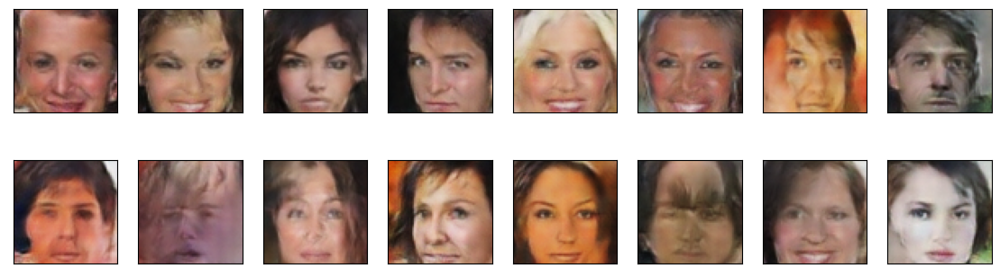

Starting Epoch [24/50]...
End of Epoch [24/50]. 2024-11-01 19:45:05 | Epoch [24/50] | Batch 508/509 | d_loss: 0.5138 | g_loss: 4.2691


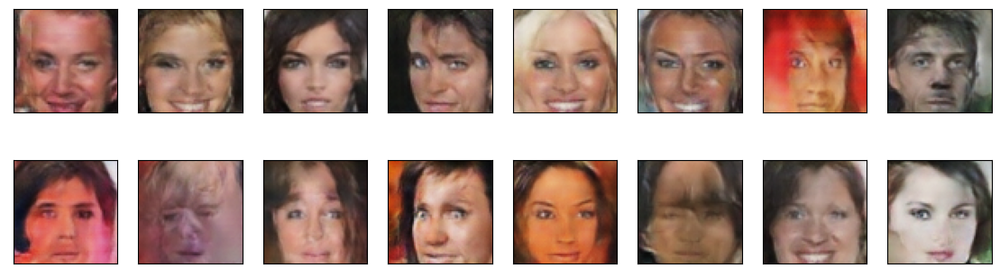

Starting Epoch [25/50]...
End of Epoch [25/50]. 2024-11-01 19:47:07 | Epoch [25/50] | Batch 508/509 | d_loss: 1.7220 | g_loss: 6.4401


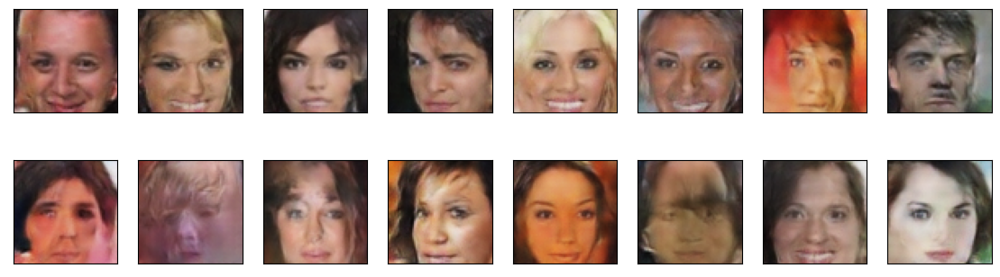

Starting Epoch [26/50]...
End of Epoch [26/50]. 2024-11-01 19:49:09 | Epoch [26/50] | Batch 508/509 | d_loss: 0.8203 | g_loss: 0.9184


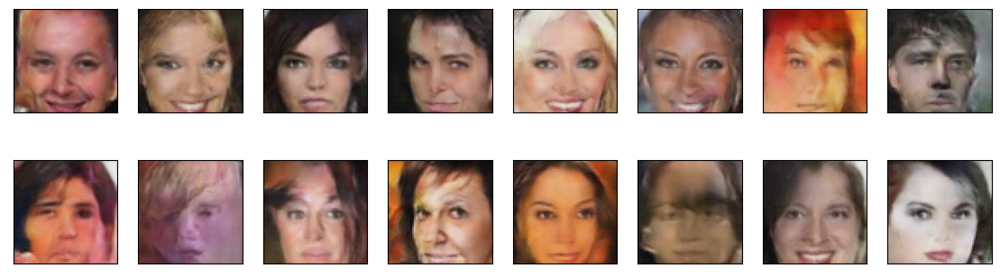

Starting Epoch [27/50]...
End of Epoch [27/50]. 2024-11-01 19:51:15 | Epoch [27/50] | Batch 508/509 | d_loss: 0.0818 | g_loss: 3.8678


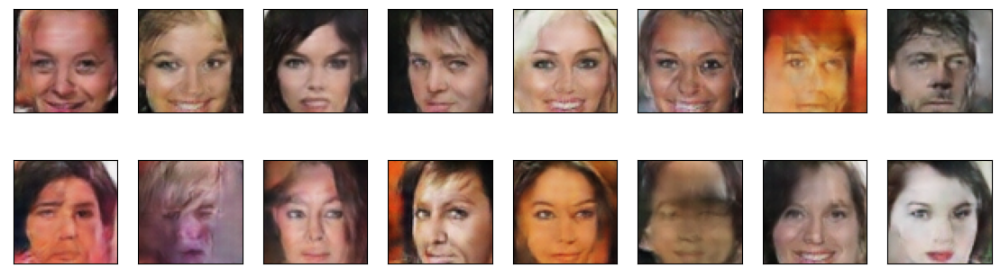

Starting Epoch [28/50]...
End of Epoch [28/50]. 2024-11-01 19:53:22 | Epoch [28/50] | Batch 508/509 | d_loss: 1.4045 | g_loss: 5.0645


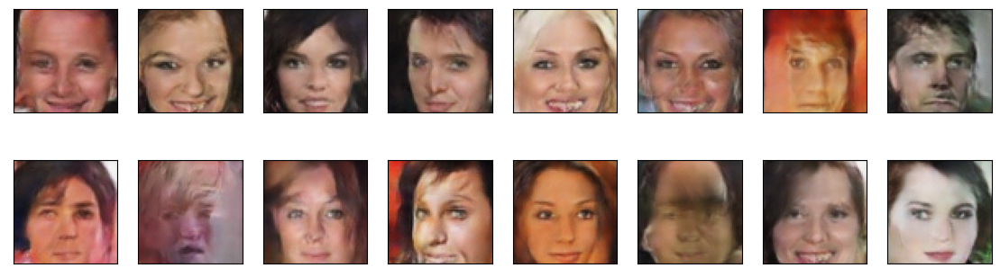

Starting Epoch [29/50]...
End of Epoch [29/50]. 2024-11-01 19:55:25 | Epoch [29/50] | Batch 508/509 | d_loss: 0.3280 | g_loss: 3.7874


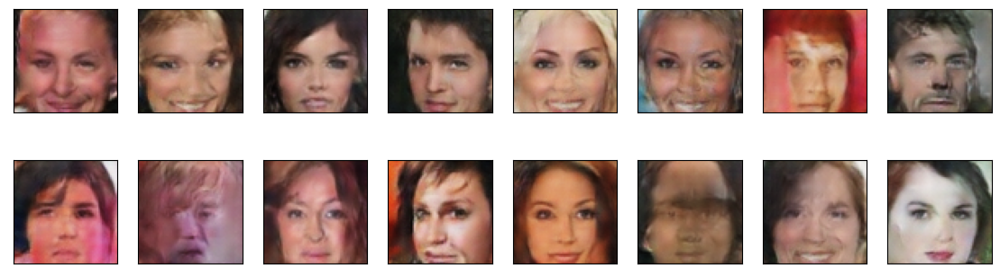

Starting Epoch [30/50]...
End of Epoch [30/50]. 2024-11-01 19:57:26 | Epoch [30/50] | Batch 508/509 | d_loss: 0.9399 | g_loss: 3.7612


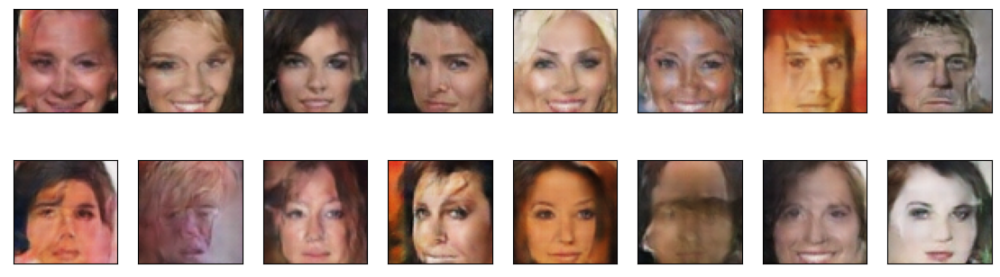

Starting Epoch [31/50]...
End of Epoch [31/50]. 2024-11-01 19:59:28 | Epoch [31/50] | Batch 508/509 | d_loss: 0.1053 | g_loss: 4.5860


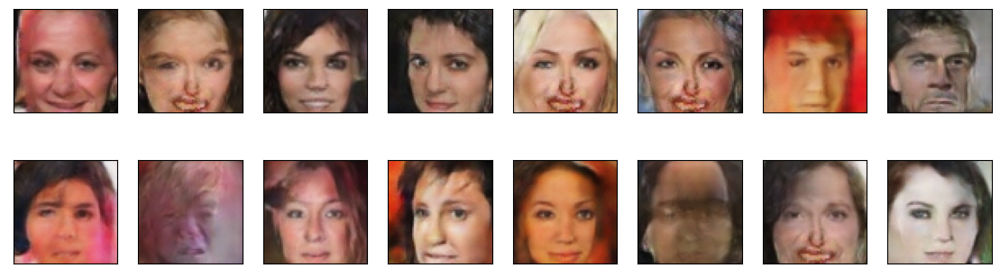

Starting Epoch [32/50]...
End of Epoch [32/50]. 2024-11-01 20:01:32 | Epoch [32/50] | Batch 508/509 | d_loss: 0.0920 | g_loss: 4.4004


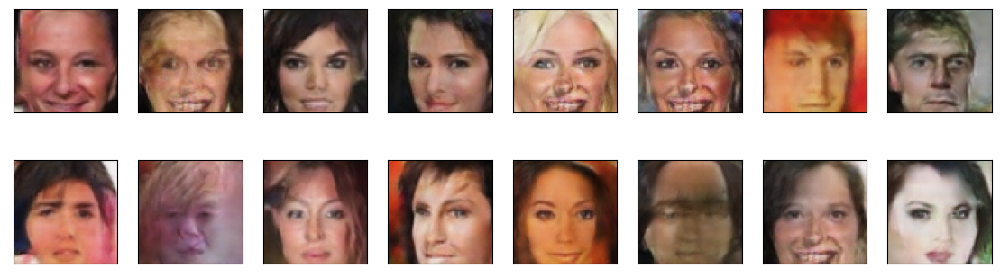

Starting Epoch [33/50]...
End of Epoch [33/50]. 2024-11-01 20:03:35 | Epoch [33/50] | Batch 508/509 | d_loss: 0.1588 | g_loss: 3.4051


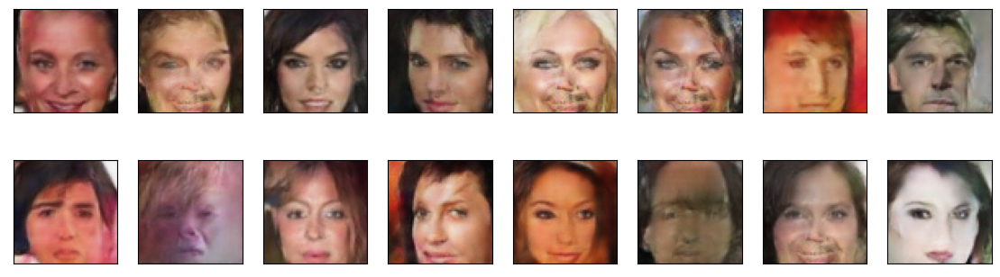

Starting Epoch [34/50]...
End of Epoch [34/50]. 2024-11-01 20:05:40 | Epoch [34/50] | Batch 508/509 | d_loss: 0.0980 | g_loss: 3.7069


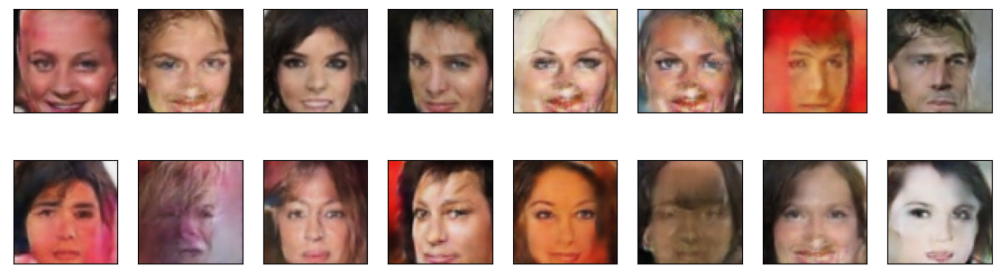

Starting Epoch [35/50]...
End of Epoch [35/50]. 2024-11-01 20:07:46 | Epoch [35/50] | Batch 508/509 | d_loss: 0.1126 | g_loss: 3.9702


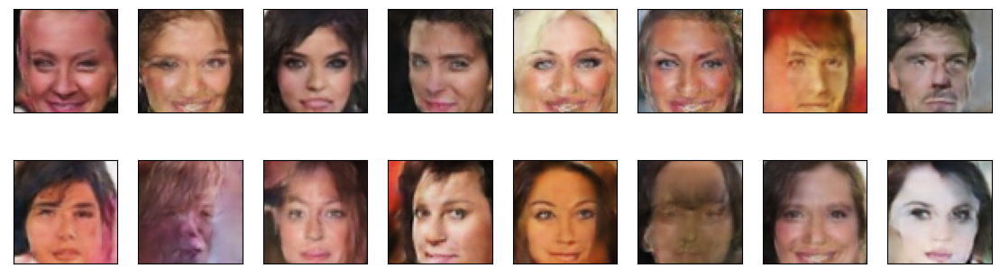

Starting Epoch [36/50]...
End of Epoch [36/50]. 2024-11-01 20:09:52 | Epoch [36/50] | Batch 508/509 | d_loss: 0.0961 | g_loss: 5.3729


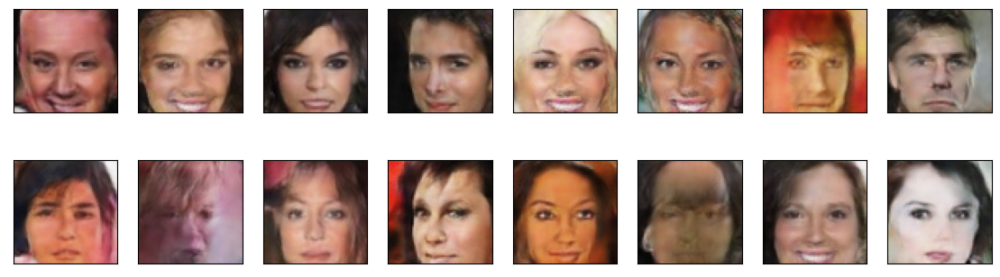

Starting Epoch [37/50]...
End of Epoch [37/50]. 2024-11-01 20:11:56 | Epoch [37/50] | Batch 508/509 | d_loss: 0.0801 | g_loss: 4.1903


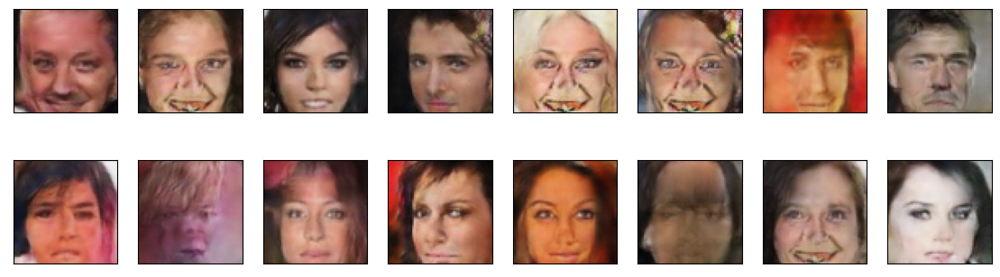

Starting Epoch [38/50]...
End of Epoch [38/50]. 2024-11-01 20:13:58 | Epoch [38/50] | Batch 508/509 | d_loss: 0.0468 | g_loss: 4.8736


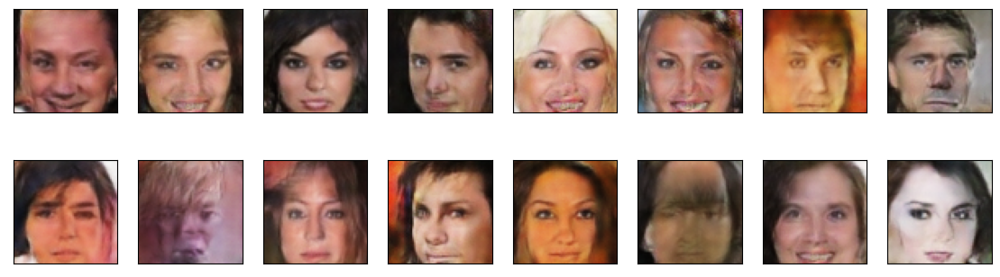

Starting Epoch [39/50]...
End of Epoch [39/50]. 2024-11-01 20:16:00 | Epoch [39/50] | Batch 508/509 | d_loss: 0.0459 | g_loss: 5.1289


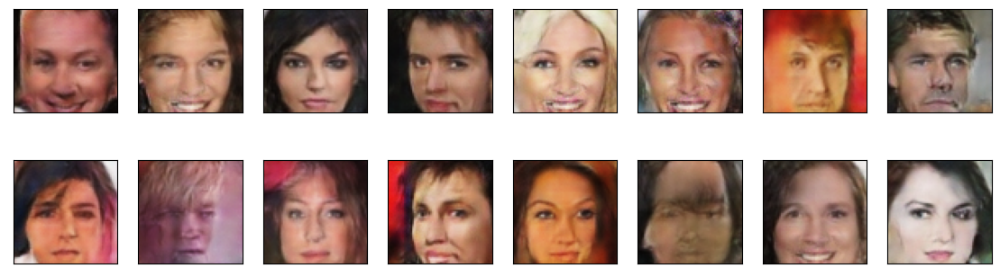

Starting Epoch [40/50]...
End of Epoch [40/50]. 2024-11-01 20:18:07 | Epoch [40/50] | Batch 508/509 | d_loss: 0.0901 | g_loss: 3.7732


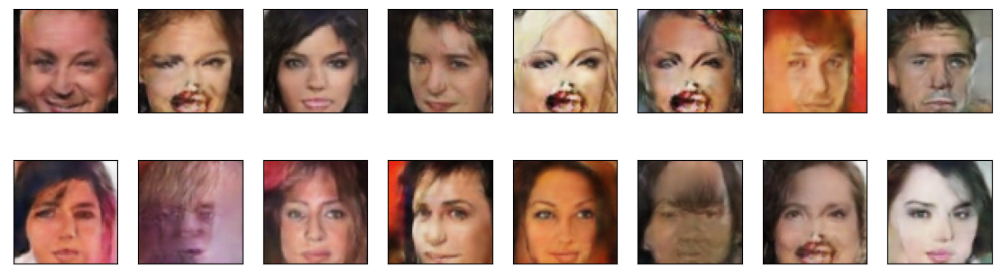

Starting Epoch [41/50]...
End of Epoch [41/50]. 2024-11-01 20:20:13 | Epoch [41/50] | Batch 508/509 | d_loss: 0.0177 | g_loss: 5.1816


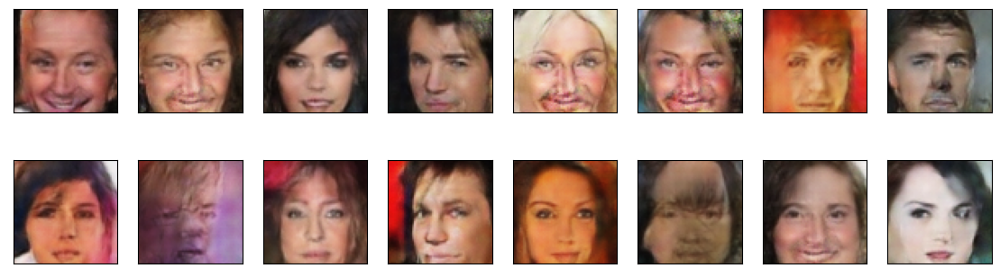

Starting Epoch [42/50]...
End of Epoch [42/50]. 2024-11-01 20:22:14 | Epoch [42/50] | Batch 508/509 | d_loss: 0.0361 | g_loss: 5.2459


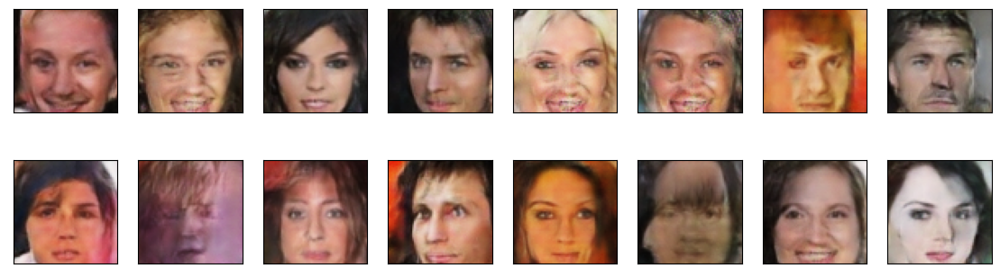

Starting Epoch [43/50]...
End of Epoch [43/50]. 2024-11-01 20:24:15 | Epoch [43/50] | Batch 508/509 | d_loss: 0.0453 | g_loss: 5.7086


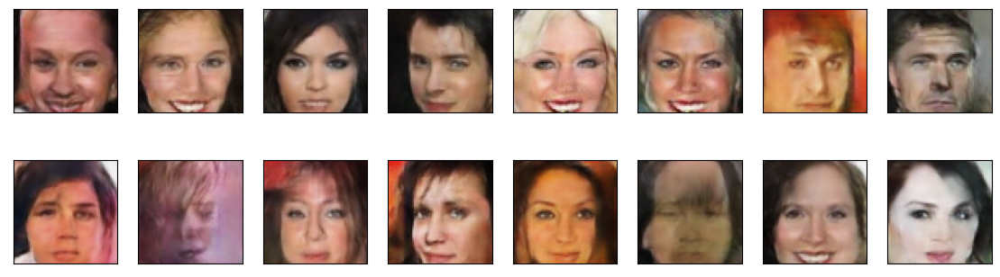

Starting Epoch [44/50]...
End of Epoch [44/50]. 2024-11-01 20:26:16 | Epoch [44/50] | Batch 508/509 | d_loss: 0.0492 | g_loss: 4.4198


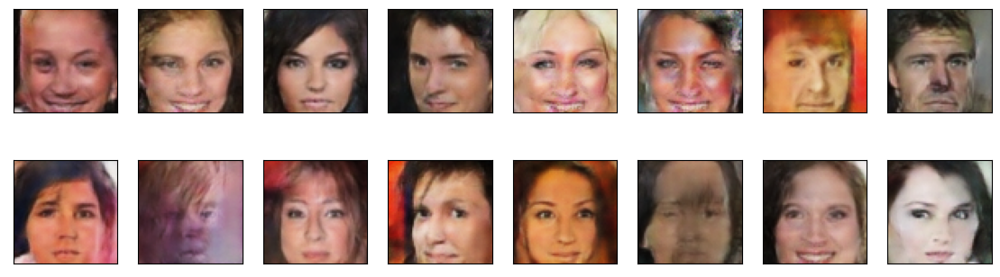

Starting Epoch [45/50]...
End of Epoch [45/50]. 2024-11-01 20:28:17 | Epoch [45/50] | Batch 508/509 | d_loss: 0.0769 | g_loss: 3.9152


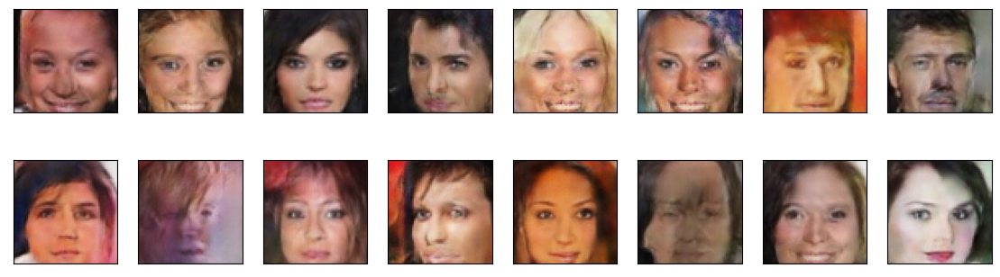

Starting Epoch [46/50]...
End of Epoch [46/50]. 2024-11-01 20:30:18 | Epoch [46/50] | Batch 508/509 | d_loss: 0.0572 | g_loss: 3.3547


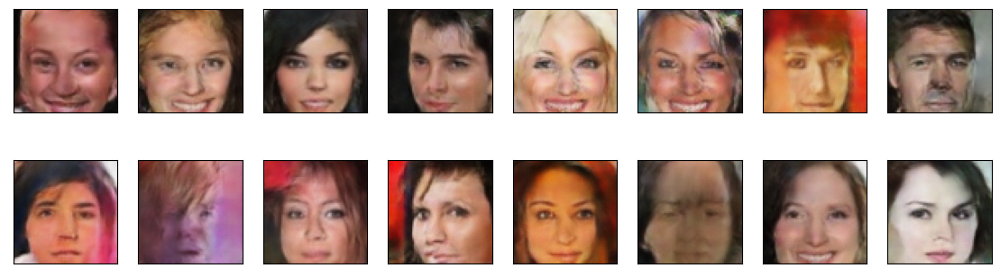

Starting Epoch [47/50]...
End of Epoch [47/50]. 2024-11-01 20:32:19 | Epoch [47/50] | Batch 508/509 | d_loss: 0.0735 | g_loss: 4.4590


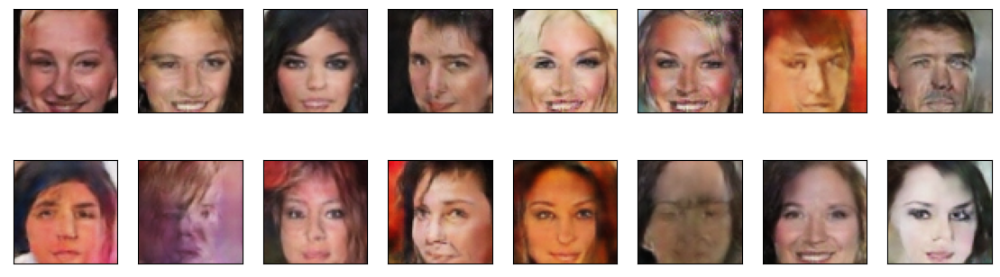

Starting Epoch [48/50]...
End of Epoch [48/50]. 2024-11-01 20:34:19 | Epoch [48/50] | Batch 508/509 | d_loss: 0.1185 | g_loss: 6.1540


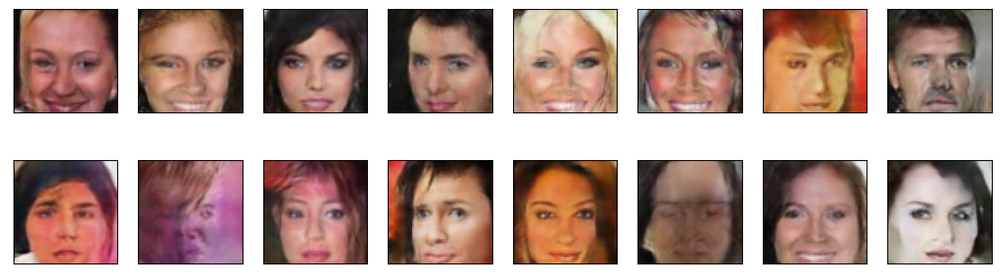

Starting Epoch [49/50]...
End of Epoch [49/50]. 2024-11-01 20:36:18 | Epoch [49/50] | Batch 508/509 | d_loss: 0.0331 | g_loss: 5.6865


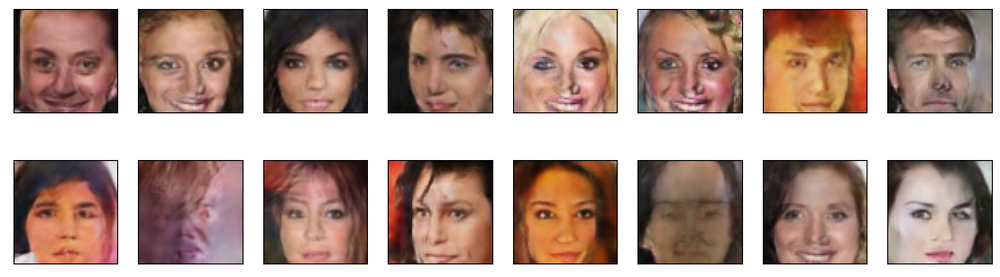

Starting Epoch [50/50]...
End of Epoch [50/50]. 2024-11-01 20:38:18 | Epoch [50/50] | Batch 508/509 | d_loss: 0.0614 | g_loss: 5.7153


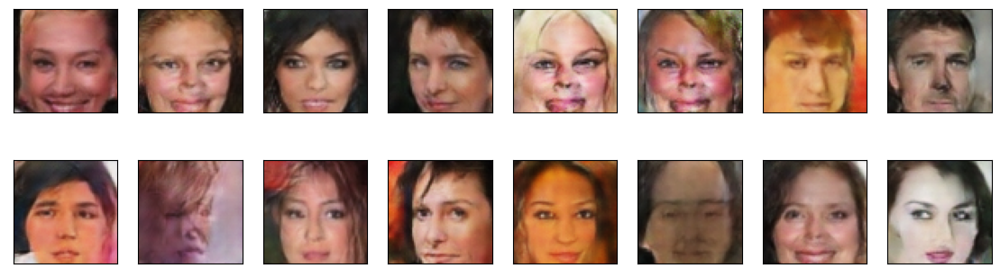

Training complete.


In [42]:
from datetime import datetime
from torch.optim.lr_scheduler import StepLR

# Fixed latent vector for visualizing generator's progress
fixed_latent_vector = torch.randn(16, latent_dim, 1, 1).to(device)

losses = []

# Define the learning rate schedulers
d_scheduler = StepLR(d_optimizer, step_size=30, gamma=0.5)  # Reduce LR every 30 epochs
g_scheduler = StepLR(g_optimizer, step_size=30, gamma=0.5)

for epoch in range(n_epochs):
    print(f"Starting Epoch [{epoch + 1}/{n_epochs}]...")  # Start of each epoch

    for batch_i, real_images in enumerate(dataloader):
        real_images = real_images.to(device)

        ####################################
        # Train the discriminator
        d_loss = discriminator_step(
            generator, discriminator, d_optimizer,
            batch_size, latent_dim, real_images, device
        )

        # Train the generator twice for better convergence
        g_loss = generator_step(
            generator, discriminator, g_optimizer,
            batch_size, latent_dim, device
        )
        g_loss = generator_step(
            generator, discriminator, g_optimizer,
            batch_size, latent_dim, device
        )
        ####################################

        # Append discriminator and generator losses for tracking
        d = d_loss['loss'].item()
        g = g_loss['loss'].item()
        losses.append((d, g))

        # Print loss details only at the end of the epoch
        if batch_i == len(dataloader) - 1:
            time = str(datetime.now()).split('.')[0]
            print(
                f'End of Epoch [{epoch + 1}/{n_epochs}]. {time} | Epoch [{epoch + 1}/{n_epochs}] | Batch {batch_i}/{len(dataloader)} | d_loss: {d:.4f} | g_loss: {g:.4f}')

    # Display images during training
    generator.eval()
    generated_images = generator(fixed_latent_vector)
    display(generated_images)
    generator.train()

    # Step the learning rate schedulers after each epoch
    d_scheduler.step()
    g_scheduler.step()

print("Training complete.")


### Training losses

Plot the training losses for the generator and discriminator.

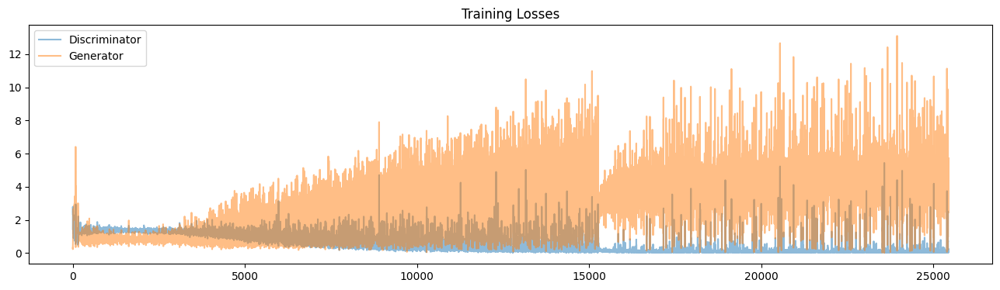

In [43]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
fig, ax = plt.subplots(figsize=(16, 4))
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()


In [4]:
!jupyter nbconvert --to html dlnd_face_generation_starter.ipynb

[NbConvertApp] Converting notebook dlnd_face_generation_starter.ipynb to html
[NbConvertApp] WARNING | Alternative text is missing on 53 image(s).
[NbConvertApp] Writing 23396174 bytes to dlnd_face_generation_starter.html


### Question: What do you notice about your generated samples and how might you improve this model?
When you answer this question, consider the following factors:
* The dataset is biased; it is made of "celebrity" faces that are mostly white
* Model size; larger models have the opportunity to learn more features in a data feature space
* Optimization strategy; optimizers and number of epochs affect your final result
* Loss functions

**Answer:** The generated faces show reasonable structure but lack fine details and diversity, with noticeable artifacts and blurriness. The training graphs indicate instability in generator performance (high fluctuating loss) while the discriminator remains relatively stable. The model could be improved by increasing model capacity, implementing WGAN-GP loss with gradient penalty, using progressive growing architecture, and most importantly, training for more epochs with a more diverse dataset to address the current bias towards white celebrities.

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb".  

Submit the notebook using the ***SUBMIT*** button in the bottom right corner of the Project Workspace.